# ZESTIMATE 
## CAPSTONE PROJECT #1 FOR SPRINGBOARD DATA SCIENCE CAREER TRACK
### BY THEO PUJIANTO

The capstone project is using the data from: https://www.kaggle.com/c/zillow-prize-1/overview .

This project is creating a model to lower Mean Absolute Error between the predicted log error and the actual log error. The log error is defined as logerror=log(Zestimate)−log(SalePrice) and it is recorded in the transactions training data. 

**Disclaimer**

This project was not and will not be submitted to the competition.<br>
If the project is lack of originality is because <b>it is not</b>. This project main purpose is to incorporate all the new skills I have obtained through my data science course. While doing so, I did some googling and read through other people's posts about the same and/or similar projects. My main objectives were to understand what's going on in their posts, their techniques and why they chose certain ways, then to be able to replicate that here.

## Preparation

### Import Modules

In [2]:
# Essentials
import numpy as np
import pandas as pd
import datetime
import random

# Plots®
import seaborn as sns
import matplotlib.pyplot as plt

# Models
# from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor, BaggingRegressor
# from sklearn.kernel_ridge import KernelRidge
# from sklearn.linear_model import Ridge, RidgeCV
# from sklearn.linear_model import ElasticNet, ElasticNetCV
# # from sklearn.svm import SVR
# # from mlxtend.regressor import StackingCVRegressor
# import lightgbm as lgb
# from lightgbm import LGBMRegressor
# from xgboost import XGBRegressor

# Stats
from scipy.stats import skew, norm
from scipy.special import boxcox1p
from scipy.stats import boxcox_normmax

# Misc
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Model PyCaret
from pycaret.regression import *

pd.set_option('display.max_columns', None)

# Ignore useless warnings
import warnings
warnings.filterwarnings(action="ignore")
pd.options.display.max_seq_items = 8000
pd.options.display.max_rows = 8000


From Kaggle we were given (5) spreadsheet files:

* properties_2016.csv - all the properties with their home features for 2016.
* properties_2017.csv - all the properties with their home features for 2017.
* train_2016.csv - the training set with transactions from 1/1/2016 to 12/31/2016.
* train_2017.csv - the training set with transactions from 1/1/2017 to 9/15/2017.
* sample_submission.csv - a sample submission file in the correct format

For my capstone project, I will only be using 2016 data.

### Import Data

In [3]:
# assign filepath into specific variables
train2016_filepath = 'zillow-prize-1/train_2016_v2.csv'
prop2016_filepath = 'zillow-prize-1/properties_2016.csv'

In [4]:
# import 2016 training data to variable: train2016; parse dates: "transactiondate"
train2016 = pd.read_csv(train2016_filepath, parse_dates =["transactiondate"])
# import 2016 property data to variable: prop2016
prop2016 = pd.read_csv(prop2016_filepath)

# shape
print("The shape of the train2016 data:", train2016.shape)
print("The shape of the 2016 property data: ",prop2016.shape)


The shape of the train2016 data: (90275, 3)
The shape of the 2016 property data:  (2985217, 58)


In [5]:
train2016.head()

,parcelid,logerror,transactiondate
0,11016594,0.0276,2016-01-01
1,14366692,-0.1684,2016-01-01
2,12098116,-0.0040,2016-01-01
3,12643413,0.0218,2016-01-02
4,14432541,-0.0050,2016-01-02


In [6]:
prop2016.head()

,parcelid,airconditioningtypeid,architecturalstyletypeid,basementsqft,bathroomcnt,bedroomcnt,buildingclasstypeid,buildingqualitytypeid,calculatedbathnbr,decktypeid,finishedfloor1squarefeet,calculatedfinishedsquarefeet,finishedsquarefeet12,finishedsquarefeet13,finishedsquarefeet15,finishedsquarefeet50,finishedsquarefeet6,fips,fireplacecnt,fullbathcnt,garagecarcnt,garagetotalsqft,hashottuborspa,heatingorsystemtypeid,latitude,longitude,lotsizesquarefeet,poolcnt,poolsizesum,pooltypeid10,pooltypeid2,pooltypeid7,propertycountylandusecode,propertylandusetypeid,propertyzoningdesc,rawcensustractandblock,regionidcity,regionidcounty,regionidneighborhood,regionidzip,roomcnt,storytypeid,threequarterbathnbr,typeconstructiontypeid,unitcnt,yardbuildingsqft17,yardbuildingsqft26,yearbuilt,numberofstories,fireplaceflag,structuretaxvaluedollarcnt,taxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,taxamount,taxdelinquencyflag,taxdelinquencyyear,censustractandblock
0,10754147,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,NaN,NaN,34144442.0,-118654084.0,85768.0,NaN,NaN,NaN,NaN,NaN,010D,269.0,NaN,6.037800e+07,37688.0,3101.0,NaN,96337.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.0,2015.0,9.0,NaN,NaN,NaN,NaN
1,10759547,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,NaN,NaN,34140430.0,-118625364.0,4083.0,NaN,NaN,NaN,NaN,NaN,0109,261.0,LCA11*,6.037800e+07,37688.0,3101.0,NaN,96337.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27516.0,2015.0,27516.0,NaN,NaN,NaN,NaN
2,10843547,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,73026.0,NaN,NaN,73026.0,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,NaN,NaN,33989359.0,-118394633.0,63085.0,NaN,NaN,NaN,NaN,NaN,1200,47.0,LAC2,6.037703e+07,51617.0,3101.0,NaN,96095.0,0.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,650756.0,1413387.0,2015.0,762631.0,20800.37,NaN,NaN,NaN
3,10859147,NaN,NaN,NaN,0.0,0.0,3.0,7.0,NaN,NaN,NaN,5068.0,NaN,NaN,5068.0,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,NaN,NaN,34148863.0,-118437206.0,7521.0,NaN,NaN,NaN,NaN,NaN,1200,47.0,LAC2,6.037141e+07,12447.0,3101.0,27080.0,96424.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,1948.0,1.0,NaN,571346.0,1156834.0,2015.0,585488.0,14557.57,NaN,NaN,NaN
4,10879947,NaN,NaN,NaN,0.0,0.0,4.0,NaN,NaN,NaN,NaN,1776.0,NaN,NaN,1776.0,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,NaN,NaN,34194168.0,-118385816.0,8512.0,NaN,NaN,NaN,NaN,NaN,1210,31.0,LAM1,6.037123e+07,12447.0,3101.0,46795.0,96450.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1947.0,NaN,NaN,193796.0,433491.0,2015.0,239695.0,5725.17,NaN,NaN,NaN


## EDA

Combine the training data and property data.

In [7]:
# merge the dataframe 
merged = pd.merge(left=train2016, right=prop2016,on='parcelid')

# print the shape of merged dataframe

print("The shape of the merged data: ", merged.shape)
# print the first 5 to check
merged.head()

The shape of the merged data:  (90275, 60)


,parcelid,logerror,transactiondate,airconditioningtypeid,architecturalstyletypeid,basementsqft,bathroomcnt,bedroomcnt,buildingclasstypeid,buildingqualitytypeid,calculatedbathnbr,decktypeid,finishedfloor1squarefeet,calculatedfinishedsquarefeet,finishedsquarefeet12,finishedsquarefeet13,finishedsquarefeet15,finishedsquarefeet50,finishedsquarefeet6,fips,fireplacecnt,fullbathcnt,garagecarcnt,garagetotalsqft,hashottuborspa,heatingorsystemtypeid,latitude,longitude,lotsizesquarefeet,poolcnt,poolsizesum,pooltypeid10,pooltypeid2,pooltypeid7,propertycountylandusecode,propertylandusetypeid,propertyzoningdesc,rawcensustractandblock,regionidcity,regionidcounty,regionidneighborhood,regionidzip,roomcnt,storytypeid,threequarterbathnbr,typeconstructiontypeid,unitcnt,yardbuildingsqft17,yardbuildingsqft26,yearbuilt,numberofstories,fireplaceflag,structuretaxvaluedollarcnt,taxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,taxamount,taxdelinquencyflag,taxdelinquencyyear,censustractandblock
0,11016594,0.0276,2016-01-01,1.0,NaN,NaN,2.0,3.0,NaN,4.0,2.0,NaN,NaN,1684.0,1684.0,NaN,NaN,NaN,NaN,6037.0,NaN,2.0,NaN,NaN,NaN,2.0,34280990.0,-118488536.0,7528.0,NaN,NaN,NaN,NaN,NaN,0100,261.0,LARS,6.037107e+07,12447.0,3101.0,31817.0,96370.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1959.0,NaN,NaN,122754.0,360170.0,2015.0,237416.0,6735.88,NaN,NaN,6.037107e+13
1,14366692,-0.1684,2016-01-01,NaN,NaN,NaN,3.5,4.0,NaN,NaN,3.5,NaN,NaN,2263.0,2263.0,NaN,NaN,NaN,NaN,6059.0,NaN,3.0,2.0,468.0,NaN,NaN,33668120.0,-117677556.0,3643.0,NaN,NaN,NaN,NaN,NaN,1,261.0,NaN,6.059052e+07,32380.0,1286.0,NaN,96962.0,0.0,NaN,1.0,NaN,NaN,NaN,NaN,2014.0,NaN,NaN,346458.0,585529.0,2015.0,239071.0,10153.02,NaN,NaN,NaN
2,12098116,-0.0040,2016-01-01,1.0,NaN,NaN,3.0,2.0,NaN,4.0,3.0,NaN,NaN,2217.0,2217.0,NaN,NaN,NaN,NaN,6037.0,NaN,3.0,NaN,NaN,NaN,2.0,34136312.0,-118175032.0,11423.0,NaN,NaN,NaN,NaN,NaN,0100,261.0,PSR6,6.037464e+07,47019.0,3101.0,275411.0,96293.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1940.0,NaN,NaN,61994.0,119906.0,2015.0,57912.0,11484.48,NaN,NaN,6.037464e+13
3,12643413,0.0218,2016-01-02,1.0,NaN,NaN,2.0,2.0,NaN,4.0,2.0,NaN,NaN,839.0,839.0,NaN,NaN,NaN,NaN,6037.0,NaN,2.0,NaN,NaN,NaN,2.0,33755800.0,-118309000.0,70859.0,NaN,NaN,NaN,NaN,NaN,010C,266.0,LAR3,6.037296e+07,12447.0,3101.0,54300.0,96222.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1987.0,NaN,NaN,171518.0,244880.0,2015.0,73362.0,3048.74,NaN,NaN,6.037296e+13
4,14432541,-0.0050,2016-01-02,NaN,NaN,NaN,2.5,4.0,NaN,NaN,2.5,NaN,NaN,2283.0,2283.0,NaN,NaN,NaN,NaN,6059.0,NaN,2.0,2.0,598.0,NaN,NaN,33485643.0,-117700234.0,6000.0,1.0,NaN,NaN,NaN,1.0,122,261.0,NaN,6.059042e+07,17686.0,1286.0,NaN,96961.0,8.0,NaN,1.0,NaN,NaN,NaN,NaN,1981.0,2.0,NaN,169574.0,434551.0,2015.0,264977.0,5488.96,NaN,NaN,6.059042e+13


### Renaming the features

The feature names will be renamed for more interpretability.

In [8]:
merged= merged.rename(columns=
  {'id_parcel': 'parcelid',
  'build_year': 'yearbuilt',
  'area_basement': 'basementsqft',
  'area_patio': 'yardbuildingsqft17',
  'area_shed': 'yardbuildingsqft26', 
  'area_pool': 'poolsizesum',  
  'area_lot': 'lotsizesquarefeet', 
  'area_garage': 'garagetotalsqft',
  'area_firstfloor_finished': 'finishedfloor1squarefeet',
  'area_total_calc': 'calculatedfinishedsquarefeet',
  'area_base': 'finishedsquarefeet6',
  'area_live_finished': 'finishedsquarefeet12',
  'area_liveperi_finished': 'finishedsquarefeet13',
  'area_total_finished': 'finishedsquarefeet15',  
  'area_unknown': 'finishedsquarefeet50',
  'num_unit': 'unitcnt', 
  'num_story': 'numberofstories',  
  'num_room': 'roomcnt',
  'num_bathroom': 'bathroomcnt',
  'num_bedroom': 'bedroomcnt',
  'num_bathroom_calc': 'calculatedbathnbr',
  'num_bath': 'fullbathcnt',  
  'num_75_bath': 'threequarterbathnbr', 
  'num_fireplace': 'fireplacecnt',
  'num_pool': 'poolcnt',  
  'num_garage': 'garagecarcnt',  
  'region_county': 'regionidcounty',
  'region_city': 'regionidcity',
  'region_zip': 'regionidzip',
  'region_neighbor': 'regionidneighborhood',  
  'tax_total': 'taxvaluedollarcnt',
  'tax_building': 'structuretaxvaluedollarcnt',
  'tax_land': 'landtaxvaluedollarcnt',
  'tax_property': 'taxamount',
  'tax_year': 'assessmentyear',
  'tax_delinquency': 'taxdelinquencyflag',
  'tax_delinquency_year': 'taxdelinquencyyear',
  'zoning_property': 'propertyzoningdesc',
  'zoning_landuse': 'propertylandusetypeid',
  'zoning_landuse_county': 'propertycountylandusecode',
  'flag_fireplace': 'fireplaceflag', 
  'flag_tub': 'hashottuborspa',
  'quality': 'buildingqualitytypeid',
  'framing': 'buildingclasstypeid',
  'material': 'typeconstructiontypeid',
  'deck': 'decktypeid',
  'story': 'storytypeid',
  'heating': 'heatingorsystemtypeid',
  'aircon': 'airconditioningtypeid',
  'architectural_style': 'architecturalstyletypeid'
})

merged.head()

,parcelid,logerror,transactiondate,airconditioningtypeid,architecturalstyletypeid,basementsqft,bathroomcnt,bedroomcnt,buildingclasstypeid,buildingqualitytypeid,calculatedbathnbr,decktypeid,finishedfloor1squarefeet,calculatedfinishedsquarefeet,finishedsquarefeet12,finishedsquarefeet13,finishedsquarefeet15,finishedsquarefeet50,finishedsquarefeet6,fips,fireplacecnt,fullbathcnt,garagecarcnt,garagetotalsqft,hashottuborspa,heatingorsystemtypeid,latitude,longitude,lotsizesquarefeet,poolcnt,poolsizesum,pooltypeid10,pooltypeid2,pooltypeid7,propertycountylandusecode,propertylandusetypeid,propertyzoningdesc,rawcensustractandblock,regionidcity,regionidcounty,regionidneighborhood,regionidzip,roomcnt,storytypeid,threequarterbathnbr,typeconstructiontypeid,unitcnt,yardbuildingsqft17,yardbuildingsqft26,yearbuilt,numberofstories,fireplaceflag,structuretaxvaluedollarcnt,taxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,taxamount,taxdelinquencyflag,taxdelinquencyyear,censustractandblock
0,11016594,0.0276,2016-01-01,1.0,NaN,NaN,2.0,3.0,NaN,4.0,2.0,NaN,NaN,1684.0,1684.0,NaN,NaN,NaN,NaN,6037.0,NaN,2.0,NaN,NaN,NaN,2.0,34280990.0,-118488536.0,7528.0,NaN,NaN,NaN,NaN,NaN,0100,261.0,LARS,6.037107e+07,12447.0,3101.0,31817.0,96370.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1959.0,NaN,NaN,122754.0,360170.0,2015.0,237416.0,6735.88,NaN,NaN,6.037107e+13
1,14366692,-0.1684,2016-01-01,NaN,NaN,NaN,3.5,4.0,NaN,NaN,3.5,NaN,NaN,2263.0,2263.0,NaN,NaN,NaN,NaN,6059.0,NaN,3.0,2.0,468.0,NaN,NaN,33668120.0,-117677556.0,3643.0,NaN,NaN,NaN,NaN,NaN,1,261.0,NaN,6.059052e+07,32380.0,1286.0,NaN,96962.0,0.0,NaN,1.0,NaN,NaN,NaN,NaN,2014.0,NaN,NaN,346458.0,585529.0,2015.0,239071.0,10153.02,NaN,NaN,NaN
2,12098116,-0.0040,2016-01-01,1.0,NaN,NaN,3.0,2.0,NaN,4.0,3.0,NaN,NaN,2217.0,2217.0,NaN,NaN,NaN,NaN,6037.0,NaN,3.0,NaN,NaN,NaN,2.0,34136312.0,-118175032.0,11423.0,NaN,NaN,NaN,NaN,NaN,0100,261.0,PSR6,6.037464e+07,47019.0,3101.0,275411.0,96293.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1940.0,NaN,NaN,61994.0,119906.0,2015.0,57912.0,11484.48,NaN,NaN,6.037464e+13
3,12643413,0.0218,2016-01-02,1.0,NaN,NaN,2.0,2.0,NaN,4.0,2.0,NaN,NaN,839.0,839.0,NaN,NaN,NaN,NaN,6037.0,NaN,2.0,NaN,NaN,NaN,2.0,33755800.0,-118309000.0,70859.0,NaN,NaN,NaN,NaN,NaN,010C,266.0,LAR3,6.037296e+07,12447.0,3101.0,54300.0,96222.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1987.0,NaN,NaN,171518.0,244880.0,2015.0,73362.0,3048.74,NaN,NaN,6.037296e+13
4,14432541,-0.0050,2016-01-02,NaN,NaN,NaN,2.5,4.0,NaN,NaN,2.5,NaN,NaN,2283.0,2283.0,NaN,NaN,NaN,NaN,6059.0,NaN,2.0,2.0,598.0,NaN,NaN,33485643.0,-117700234.0,6000.0,1.0,NaN,NaN,NaN,1.0,122,261.0,NaN,6.059042e+07,17686.0,1286.0,NaN,96961.0,8.0,NaN,1.0,NaN,NaN,NaN,NaN,1981.0,2.0,NaN,169574.0,434551.0,2015.0,264977.0,5488.96,NaN,NaN,6.059042e+13


In [9]:
# descriptive statistics summary
merged['logerror'].describe()

count    90275.000000
mean         0.011457
std          0.161079
min         -4.605000
25%         -0.025300
50%          0.006000
75%          0.039200
max          4.737000
Name: logerror, dtype: float64

In [10]:
merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90275 entries, 0 to 90274
Data columns (total 60 columns):
parcelid                        90275 non-null int64
logerror                        90275 non-null float64
transactiondate                 90275 non-null datetime64[ns]
airconditioningtypeid           28781 non-null float64
architecturalstyletypeid        261 non-null float64
basementsqft                    43 non-null float64
bathroomcnt                     90275 non-null float64
bedroomcnt                      90275 non-null float64
buildingclasstypeid             16 non-null float64
buildingqualitytypeid           57364 non-null float64
calculatedbathnbr               89093 non-null float64
decktypeid                      658 non-null float64
finishedfloor1squarefeet        6856 non-null float64
calculatedfinishedsquarefeet    89614 non-null float64
finishedsquarefeet12            85596 non-null float64
finishedsquarefeet13            33 non-null float64
finishedsquarefeet15

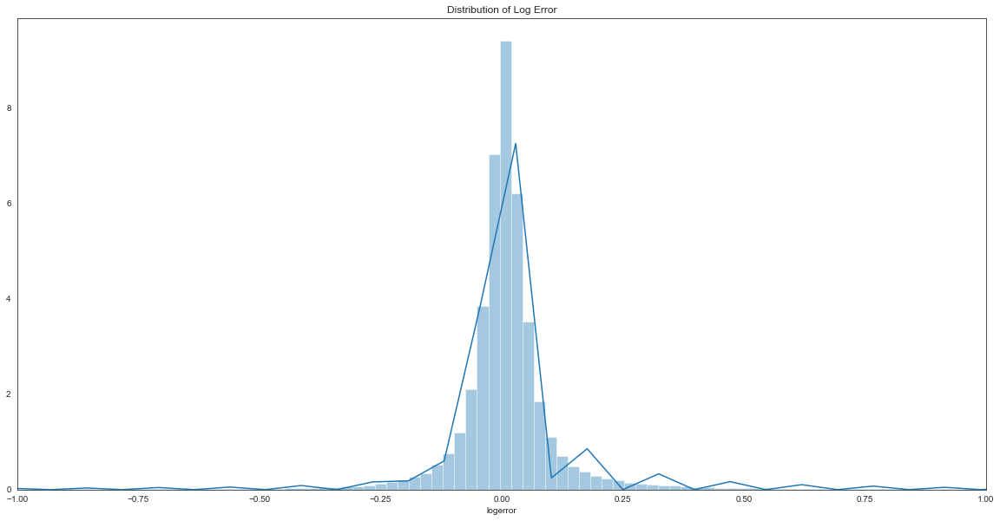

In [11]:
# visualize the logerror
sns.set_style("white")
sns.set_color_codes(palette="deep")
fig, ax = plt.subplots(figsize=(20,10))


sns.distplot(merged.logerror, bins=400, hist=True)
plt.title('Distribution of Log Error')

plt.xlim(-1, 1)
plt.show()

logerror: log(Zestimate) - log(Saleprice). So a positive logerror means Zestimate is overestimating the Saleprice, a negative logerror means that Zestimate is underestimating Saleprice.

There is a Gaussian (normal) distribution to the log error; this means that the random sample we use to test our model will have the same distribution as our overall data, and we can guard against overfitting.

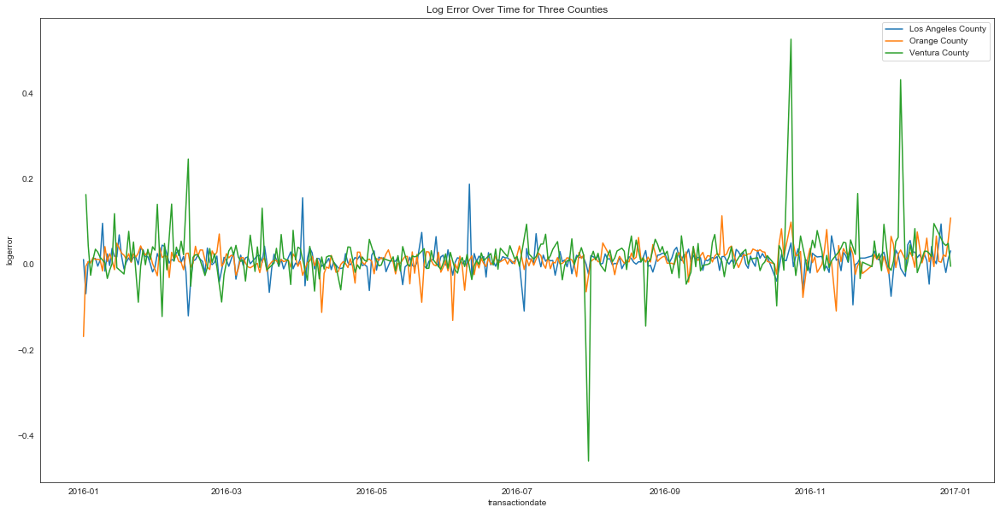

In [12]:
fips1 = pd.DataFrame(merged.loc[merged['fips']==6037].groupby('transactiondate')['logerror'].mean())
fips1.reset_index(inplace = True)
fips2 = pd.DataFrame(merged.loc[merged['fips']==6059].groupby('transactiondate')['logerror'].mean())
fips2.reset_index(inplace = True)
fips3 = pd.DataFrame(merged.loc[merged['fips']==6111].groupby('transactiondate')['logerror'].mean())
fips3.reset_index(inplace = True)

sns.set_style("white")
sns.set_color_codes(palette="deep")
fig, ax = plt.subplots(figsize=(20,10))

sns.lineplot(fips1['transactiondate'], fips1['logerror'], label="Los Angeles County")
sns.lineplot(fips2['transactiondate'], fips2['logerror'], label="Orange County")
sns.lineplot(fips3['transactiondate'], fips3['logerror'], label="Ventura County")

plt.title('Log Error Over Time for Three Counties')

plt.show()

### Correlation Matrix

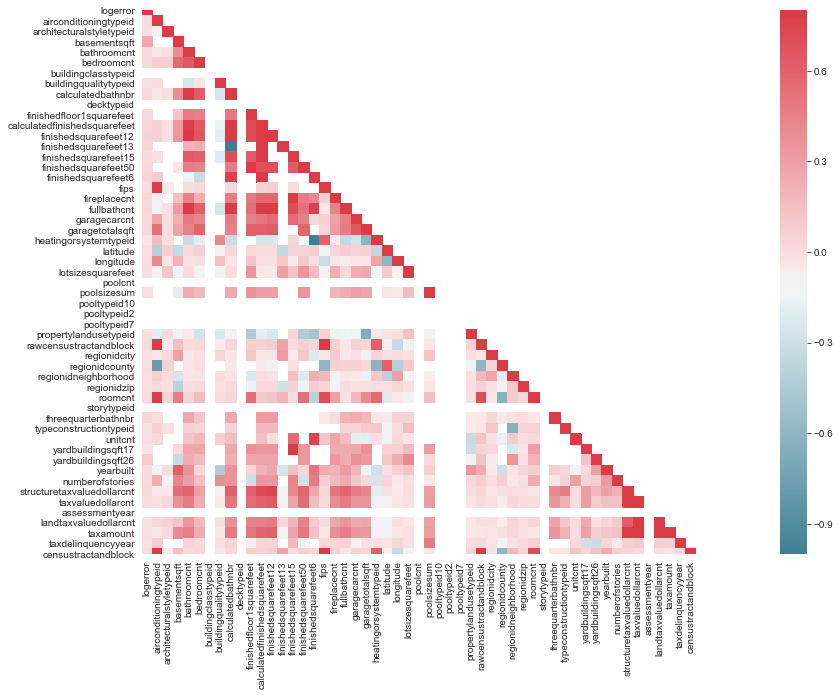

In [12]:
merged_X = merged.drop(["parcelid", "transactiondate"], axis=1)
corrMatt = merged_X.corr()
mask = np.array(corrMatt)
mask[np.tril_indices_from(mask)] = False
fig,ax= plt.subplots()
fig.set_size_inches(30,10)
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corrMatt, mask=mask,vmax=.8, square=True, cmap=cmap)
plt.show()

We looked at the correlation of numerical features with both the absolute log error and each other to identify variables that might be particularly helpful in prediction.

## Feature Engineering

### Missing Values

The property data uses 'NaN' (Not a Number) to represent missing values.

Percentage of 'NaN' compare to valid entries for each feature to be plotted below. It will show which features have a lot of missing entries.

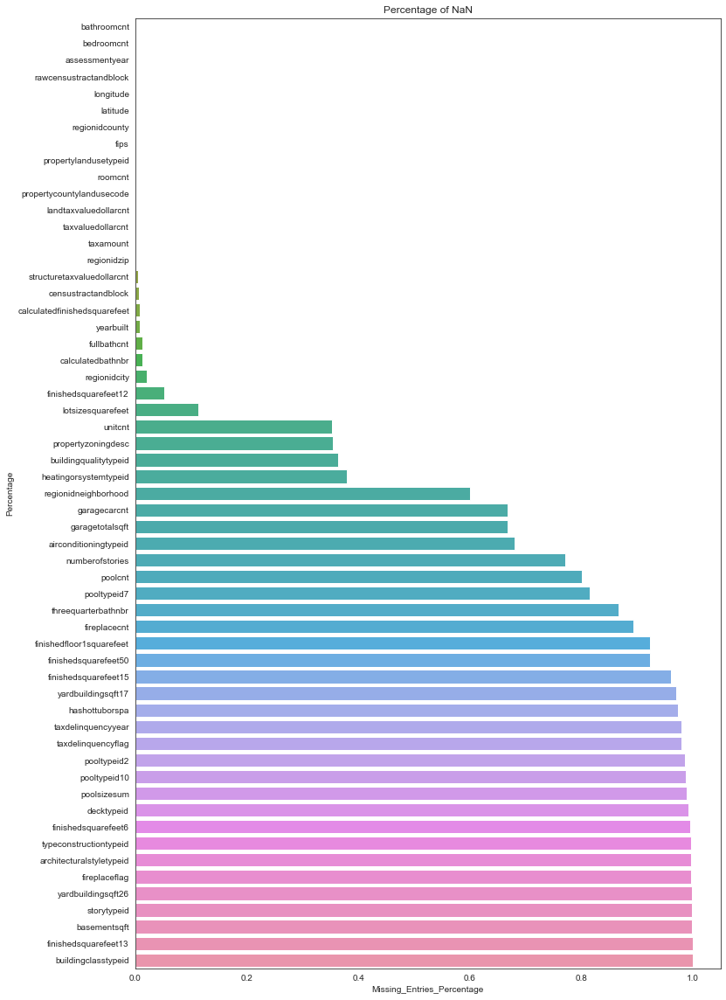

In [13]:
percentageNan = pd.DataFrame(merged.drop(['parcelid', 'logerror', 'transactiondate'], axis=1).isnull().mean().sort_values(ascending=True).reset_index().rename(columns={"index":"Features",0:"Missing_Entries_Percentage"}))
# plot bar chart for percentage of 'NaN'
fig,ax = plt.subplots()
fig.set_size_inches(12,20)
sns.set_palette("pastel")
sns.barplot(data=percentageNan, x="Missing_Entries_Percentage", y="Features", ax=ax)
ax.set(ylabel='Percentage',title="Percentage of NaN")
plt.show()

There are a lot of missing values and some of the features are highly correlated. The features will be analyzed deeper in groups.



### Pool

In [14]:
pool_cols = list(merged_X.loc[:,merged_X.columns.str.contains("pool|hottub")].columns)

print('These are the features related to pool : ', pool_cols)

These are the features related to pool :  ['hashottuborspa', 'poolcnt', 'poolsizesum', 'pooltypeid10', 'pooltypeid2', 'pooltypeid7']


* 'poolcnt' - Number of pools on a lot. Intuitively, 'NaN' most likely to be 0 or there's no pool for this property. 'NaN' entries will be filled with 0.

* 'hashottuborspa' - Does the home have a hottub or a spa? 'NaN' most likely to be 0 or there's no pool for this property. 'NaN' entries will be filled with 0.

* 'poolsizesum' - Total square footage of pools on property. There are (2) possible scenarios here. First, there is no pool for this property, which means the 'NaN' can be changed to 0. Second, where 'NaN' present for the properties with pool. For the second case, 'NaN' will be filled with the median value of the pool size squarefootage.

* 'pooltypeid2' & 'pooltypeid7' & 'pooltypeid10' - Type of pool or hottub present on property. To make it simpler for this purpose, these features will be dropped.

In [15]:
# fill 'NaN' with 0 for 'poolcnt' feature
merged['poolcnt'].fillna(0, inplace=True)

# fill 'NaN' with 0 for 'hashottuborspa' feature
merged['hashottuborspa'].fillna(0, inplace=True)

# replace "True" to 1
merged['hashottuborspa'].replace(to_replace = True, value = 1,inplace = True)

# for the case #1, set properties that do not have a pool but no info on poolsize equal to 0.
merged.loc[merged.poolcnt==0, 'poolsizesum'] = merged.loc[merged.poolcnt==0, 'poolsizesum'].fillna(0)

# for the case #2, set properties that have a pool but no info on poolsize equal to the median poolsize value.
merged.loc[merged.poolcnt==1, 'poolsizesum'] = merged.loc[merged.poolcnt==1, 'poolsizesum'].fillna(merged[merged.poolcnt==1].poolsizesum.median())

# drop unused features
merged.drop(['pooltypeid2', 'pooltypeid7', 'pooltypeid10'], axis=1, inplace=True)

### Fireplace

In [16]:
fire_cols = list(merged_X.loc[:,merged_X.columns.str.contains("fire")].columns)

print('These are the features related to fireplace : ', fire_cols)

These are the features related to fireplace :  ['fireplacecnt', 'fireplaceflag']


* 'fireplaceflag' - Does the home have a fireplace? This feature have True or False entries. 'NaN' most likely represents False. However, for this project, True and False would be better suited to be transformed to 1 and 0 respectively.
* 'fireplacecnt' - How many fireplaces in the home? 'NaN' values to be transformed to 0.



There are also the case where the 'fireplaceflag'  and 'fireplacecnt' are not align. Below is how this case will be dealt with:

* If 'fireplaceflag' is 'True' and 'fireplacecnt' is 'NaN', 'fireplacecnt' equal to the median value of '1'.
* If 'fireplacecnt' is 1 or larger 'fireplaceflag' is 'NaN', 'fireplaceflag' to 'True'.

In [17]:
# fill 'NaN' with 0 for 'fireplaceflag' feature
merged['fireplaceflag'].fillna(0, inplace=True)

# replace "True" to 1
merged['fireplaceflag'].replace(to_replace = True, value = 1,inplace = True)

# replace "False" to 0
merged['fireplaceflag'].replace(to_replace = False, value = 0,inplace = True)

# fill 'NaN' with 0 for 'fireplacecnt' feature
merged['fireplacecnt'].fillna(0, inplace=True)

# for the case where 'fireplaceflag' "True" --> 1 and "fireplacecnt" is "NaN" --> 0, 'fireplacecnt' equal to the median value of 1
merged.loc[(merged['fireplaceflag'] == 1) & (merged['fireplacecnt'] == 0), ['fireplacecnt']] = 1

# for the case where 'fireplacecnt' >= 1 and "fireplaceflag" is "NaN" --> 0, 'fireplaceflag' equal to 1
merged.loc[(merged['fireplacecnt'] >= 1.0) & (merged['fireplaceflag'] == 0), ['fireplaceflag']] = 1

### Bathrooms

In [18]:
bath_cols = list(merged_X.loc[:,merged_X.columns.str.contains("bath")].columns)

print('These are the features related to bathrooms : ',bath_cols)

These are the features related to bathrooms :  ['bathroomcnt', 'calculatedbathnbr', 'fullbathcnt', 'threequarterbathnbr']


* 'threequarterbathnbr' - Number of 3/4 baths = shower, sink, toilet.

* 'fullbathcnt' - Number of full bathrooms - tub, sink, toilet

* 'calculatedbathnbr' - Total number of bathrooms including partials.

Again, to simplify 'threequarterbathnbr' and 'fullbathcnt' will be dropped, the assumption is that 'calculatedbathnbr' incorporate the other (2) features. 

### Tax

In [19]:
tax_cols = list(merged_X.loc[:,merged_X.columns.str.contains("tax")].columns)

print('These are the features related to tax : ',tax_cols)

These are the features related to tax :  ['structuretaxvaluedollarcnt', 'taxvaluedollarcnt', 'landtaxvaluedollarcnt', 'taxamount', 'taxdelinquencyflag', 'taxdelinquencyyear']


In [20]:
# fill "NaN" with "0"
merged.taxdelinquencyflag.fillna(0,inplace = True)

# replace "Y" to "1"
merged.taxdelinquencyflag.replace(to_replace = 'Y', value = 1,inplace = True)

# drop "taxdelinquencyyear"
merged.drop('taxdelinquencyyear', axis=1, inplace=True)

# fill 'NaN' with 0 for 'landtaxvaluedollarcnt' feature
merged['landtaxvaluedollarcnt'].fillna(0, inplace=True)

# fill 'NaN' with 0 for 'structuretaxvaluedollarcnt' feature
merged['structuretaxvaluedollarcnt'].fillna(0, inplace=True)

# fill 'NaN' with the average for 'taxvaluedollarcnt' feature
merged['taxvaluedollarcnt'].fillna((merged['taxvaluedollarcnt'].mean()), inplace=True)

# fill 'NaN' with the average for 'taxamount' feature
merged['taxamount'].fillna((merged['taxamount'].mean()), inplace=True)

### Finished SQFT

In [21]:
sqft_cols = list(merged_X.loc[:,merged_X.columns.str.contains("finishedsquare")].columns)

print('These are the features related to tax : ',sqft_cols)

These are the features related to tax :  ['calculatedfinishedsquarefeet', 'finishedsquarefeet12', 'finishedsquarefeet13', 'finishedsquarefeet15', 'finishedsquarefeet50', 'finishedsquarefeet6']


In [22]:
# drop unused features
prop2016.drop(['finishedsquarefeet13', 'finishedsquarefeet6', 'finishedsquarefeet15', 'finishedsquarefeet50', 'finishedsquarefeet6', 'finishedsquarefeet50', 'finishedfloor1squarefeet'], axis=1, inplace=True)

# present in 98%. Total finished living area of home. Let's fill the rest with the average values.
prop2016['calculatedfinishedsquarefeet'].fillna(prop2016['calculatedfinishedsquarefeet'].mean(), inplace=True)

To look at 'finishedfloor1squarefeet', 'numberofstories' need to be considered as well.

- 'numberofstories' - Fill "NA" with 1.

In [23]:
# fill 'NaN' with 1 for 'numberofstories' feature
prop2016['numberofstories'].fillna(1, inplace=True)


# If "numberofstories" is equal to "1", then we can replace the "NaN"s with the "calculatedfinishedsquarefeet" value. Fill in the rest with the average values.
prop2016.loc[prop2016['numberofstories'] == 1.0,'finishedsquarefeet50'] = prop2016['calculatedfinishedsquarefeet']
prop2016['finishedsquarefeet50'].fillna((prop2016['finishedsquarefeet50'].mean()), inplace=True)

## MISCELLANEOUS

* 'storytypeid' - Numerical ID that describes all types of homes. To simplify this feature will be dropped.

* **'basementsqft' - Square footage of basement. Replace 'NaN' with '0' to represent those properties that do not have basement.**

* **'yardbuildingsqft26' - Storage shed square footage. Replace 'NaN' with '0' to represent those properties that do not have shed.**

* 'architecturalstyletypeid' - What is the architectural style of the house? To simplify this feature will be dropped.

* 'typeconstructiontypeid' - What material is the house made out of? To simplify this feature will be dropped.

* 'buildingclasstypeid' - Describes the internal structure of the home. To simplify this feature will be dropped.

* **'decktypeid' - Type of deck (if any) on property. Looks like a value is either '66.0' or 'NaN'. Replace '66.0' to 1 (to represent the properties with deck) and 'NaN' to 0 (to represent the properties with no deck).**

* 'yardbuildingsqft17' - Patio in yard. Similar to shed? this will be dropped.

* **'airconditioningtypeid' - Replace 'NaN'to '5' for 'None'.**

* 'regionidneighborhood' - Neighborhood. Could fill in blanks. Would need a key that maps lat & longitude regions with specific neighborhoods. Because 'longitude' and 'latitude' essentially provide this information, we will drop 'regionidneighborhood'.

* **'heatingorsystemtypeid' - Change 'NaN' to '13' for 'None'**

* **'buildingqualitytypeid' - Change 'NaN' to most common value.**

* **'unitcnt' - Number of units in a property. Change 'NaN' to 1.**

* 'propertyzoningdesc' - Description of the allowed land uses (zoning) for that property. Similar to 'propertylandusetypeid'. To simplify, this feature will be dropped.

* **'lotsizesquarefeet' - Area of lot in square feet. Fill 'NaN' with average.**

* 'censustractandblock' & 'rawcensustractandblock' - Census tract and block ID combined. Both features contain similar information. 'rawcensustractandblock' to be dropped.

* 'regionidcity' - City property is located in. This is redundant information, so we will drop.

* **'yearbuilt' - Year home was built. We can just fill in the 'NaN' values with the most common value.**

In [24]:
# fill 'NaN' with 0 for 'basementsqft' feature
merged['basementsqft'].fillna(0, inplace=True)

# fill 'NaN' with 0 for 'yardbuildingsqft26' feature®
merged['yardbuildingsqft26'].fillna(0, inplace=True)

# fill 'NaN' with 0 for 'basementsqft' feature
merged['decktypeid'].fillna(0, inplace=True)

# fill '66' with 1 for 'decktypeid' feature
merged['decktypeid'].replace(to_replace=[66, '66'], value=1, inplace=True)

# fill 'NaN' with 5 for 'airconditioningtypeid' feature
merged['airconditioningtypeid'].fillna(5, inplace=True)

# fill 'NaN' with 5 for 'heatingorsystemtypeid' feature
merged['heatingorsystemtypeid'].fillna(13, inplace=True)

# fill 'NaN' with most common data for 'buildingqualitytypeid' feature
merged['buildingqualitytypeid'].fillna((merged['buildingqualitytypeid'].value_counts().argmax()), inplace=True)

# fill 'NaN' with 1 for 'unitcnt' feature
merged['unitcnt'].fillna(1, inplace=True)

# fill 'NaN' with average for 'lotsizesquarefeet' feature
merged['lotsizesquarefeet'].fillna((merged['lotsizesquarefeet'].mean()), inplace=True)

# fill 'NaN' with most common data for 'yearbuilt' feature
merged['yearbuilt'].fillna((merged['yearbuilt'].value_counts().argmax()), inplace=True)

In [25]:
drop_these = ['storytypeid', 'architecturalstyletypeid', 'typeconstructiontypeid', 'buildingclasstypeid', 'yardbuildingsqft17', 'regionidneighborhood', 'propertyzoningdesc', 'censustractandblock', 'regionidcity', 'regionidcounty']

prop2016.drop(drop_these, axis=1, inplace=True)

In [26]:
# Fill in "fips" "NaN"s
merged['fips'] = merged['fips'].fillna(merged['fips'].value_counts().argmax())

# Fill in "propertylandusetypeid" "NaN"s
merged['propertylandusetypeid'] = merged['propertylandusetypeid'].fillna(merged['propertylandusetypeid'].value_counts().argmax())

# Fill in "latitude" "NaN"s
merged['latitude'] = merged['latitude'].fillna(merged['latitude'].value_counts().argmax())

# Fill in "longitude" "NaN"s
merged['longitude'] = merged['longitude'].fillna(merged['longitude'].value_counts().argmax())

# Fill in "rawcensustractandblock" "NaN"s
merged['rawcensustractandblock'] = merged['rawcensustractandblock'].fillna(merged['rawcensustractandblock'].value_counts().argmax())

# Fill in "assessmentyear" "NaN"s
merged['assessmentyear'] = merged['assessmentyear'].fillna(merged['assessmentyear'].value_counts().argmax())

# Fill in "bedroomcnt" "NaN"s
merged['bedroomcnt'] = merged['bedroomcnt'].fillna(merged['bedroomcnt'].value_counts().argmax())

# Fill in "bathroomcnt" "NaN"s
merged['bathroomcnt'] = merged['bathroomcnt'].fillna(merged['bathroomcnt'].value_counts().argmax())

# Fill in "roomcnt" "NaN"s
merged['roomcnt'] = merged['roomcnt'].fillna(merged['roomcnt'].value_counts().argmax())

# Fill in "propertycountylandusecode" "NaN"s
merged['propertycountylandusecode'] = merged['propertycountylandusecode'].fillna(merged['propertycountylandusecode'].value_counts().argmax())

# Fill in "regionidzip " "NaN"s
merged['regionidzip'] = merged['regionidzip'].fillna(merged['regionidzip'].value_counts().argmax())

## MODEL

### Preprocessing

In [27]:
merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90275 entries, 0 to 90274
Data columns (total 56 columns):
parcelid                        90275 non-null int64
logerror                        90275 non-null float64
transactiondate                 90275 non-null datetime64[ns]
airconditioningtypeid           90275 non-null float64
architecturalstyletypeid        261 non-null float64
basementsqft                    90275 non-null float64
bathroomcnt                     90275 non-null float64
bedroomcnt                      90275 non-null float64
buildingclasstypeid             16 non-null float64
buildingqualitytypeid           90275 non-null float64
calculatedbathnbr               89093 non-null float64
decktypeid                      90275 non-null float64
finishedfloor1squarefeet        6856 non-null float64
calculatedfinishedsquarefeet    89614 non-null float64
finishedsquarefeet12            85596 non-null float64
finishedsquarefeet13            33 non-null float64
finishedsquaref

In [28]:
# drop outliers (logerror)
train_master = merged.loc[(merged.logerror > -0.4) & (merged.logerror < 0.4)]
       
print('Shape train: {}\nShape test: {}'.format(train_master.shape, train_master.shape))

Shape train: (88431, 56)
Shape test: (88431, 56)


In [32]:
reg = setup(data = train_master, 
             target = 'logerror',
             numeric_imputation = 'mean',
             categorical_features = ['propertycountylandusecode','propertyzoningdesc','fireplaceflag','taxdelinquencyflag']  , 
             ignore_features = ['parcelid','transactiondate'],
             normalize = True,
             silent = True)


Setup Succesfully Completed.


,Description,Value
0,session_id,8792
1,Transform Target,False
2,Transform Target Method,None
3,Original Data,"(88431, 56)"
4,Missing Values,True
5,Numeric Features,38
6,Categorical Features,16
7,Ordinal Features,False
8,High Cardinality Features,False
9,High Cardinality Method,None


In [47]:
# whitelist = ['lr', 'lasso', 'ridge', 'br', 'xgboost', 'lightgbm', 'rf']
whitelist = ['ridge', 'lasso', 'lr', 'lightgbm', 'br', 'catboost']
compare_models(whitelist=whitelist,fold=3, sort='RMSE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
0,Light Gradient Boosting Machine,0.0524,0.0066,0.0813,0.0229,0.0675,-0.1214,6
1,CatBoost Regressor,0.0524,0.0066,0.0813,0.0226,0.0677,-0.1261,20.76
2,Bayesian Ridge,0.0525,0.0067,0.0818,0.01,0.0697,-0.149,49.48
3,Ridge Regression,0.0534,0.0068,0.0822,0.0004,0.0679,-0.1005,7.034
4,Lasso Regression,0.0528,0.0068,0.0822,-0.0002,0.0707,-0.2381,2.806
5,Linear Regression,1.678e+07,2.622e+17,4.927e+08,-3.916e+19,2.181,-1.102e+08,17.2


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=8792, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

It looks like Light Gradient Boosting will be the model to choose.

In [48]:
lgbm_model = create_model('lightgbm', fold=5)


,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.0523,0.0065,0.0803,0.023,0.0664,-0.1868
1,0.052,0.0065,0.0806,0.029,0.0673,-0.0995
2,0.0523,0.0067,0.0818,0.0251,0.068,-0.0915
3,0.0525,0.0067,0.082,0.0197,0.0683,-0.1101
4,0.0525,0.0066,0.0814,0.0283,0.0679,-0.1626
Mean,0.0523,0.0066,0.0812,0.025,0.0676,-0.1301
SD,0.0002,0.0001,0.0006,0.0034,0.0007,0.0377


In [49]:
tuned_lightgbm = tune_model(lgbm_model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,0.052,0.0064,0.08,0.0099,0.0679,-0.1895
1,0.0525,0.0066,0.0812,0.021,0.0694,-0.2294
2,0.0516,0.0064,0.0803,0.0209,0.0687,-0.1491
3,0.0524,0.0067,0.0818,0.0148,0.07,-0.1393
4,0.0528,0.0068,0.0824,0.0163,0.0703,-0.1336
5,0.0521,0.0067,0.082,0.0128,0.0701,-0.1473
6,0.0532,0.007,0.0836,0.0113,0.0718,-0.1819
7,0.0519,0.0066,0.081,0.0117,0.0691,-0.1599
8,0.053,0.0067,0.0821,0.0127,0.0706,-0.1805
9,0.0525,0.0067,0.0818,0.0161,0.0699,-0.2297


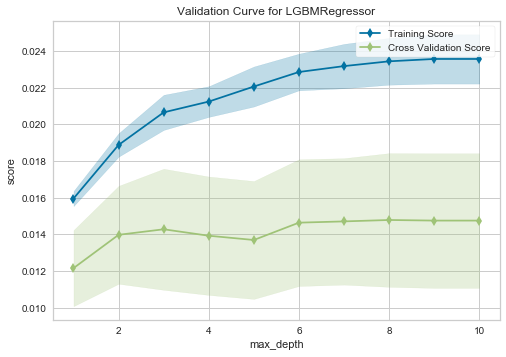

In [59]:
plot_model(estimator = tuned_lightgbm, plot = 'vc')

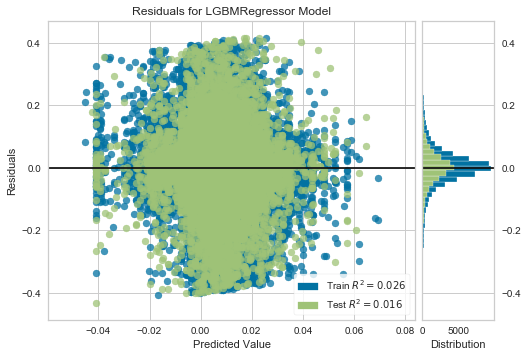

In [56]:
plot_model(estimator = tuned_lightgbm, plot = 'residuals')


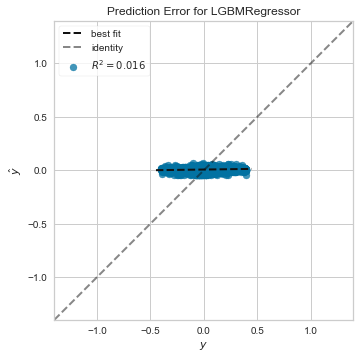

In [57]:
plot_model(estimator = tuned_lightgbm, plot = 'error')


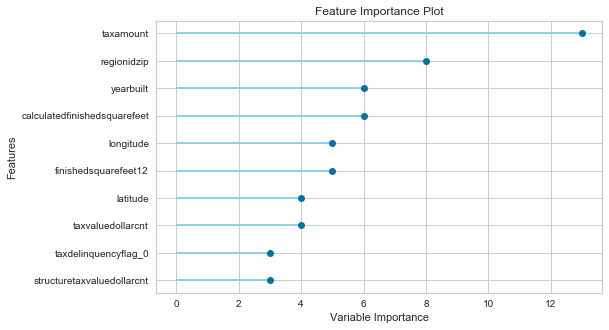

In [58]:
plot_model(estimator = tuned_lightgbm, plot = 'feature')


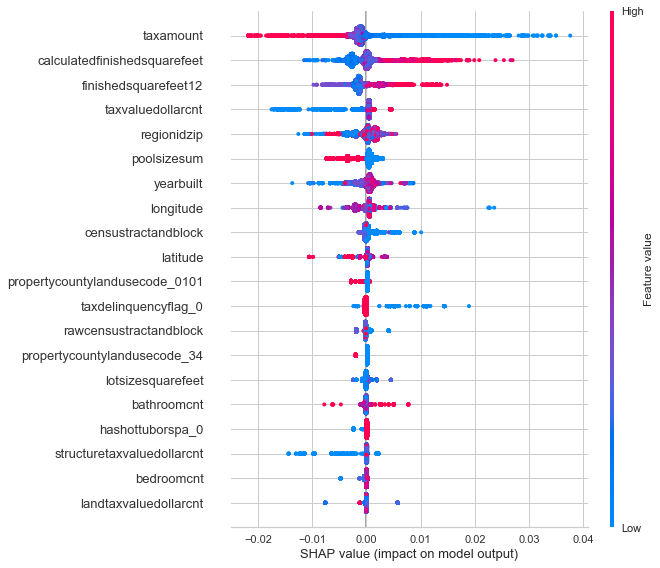

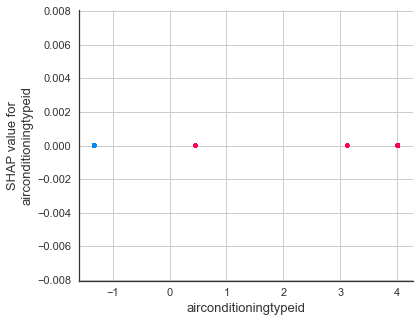

In [61]:
# interpret overall model 
interpret_model(tuned_lightgbm)
# correlation shap plot
interpret_model(tuned_lightgbm, plot = 'correlation')
# interactive reason plot
interpret_model(tuned_lightgbm, plot = 'reason')
# reason plot at observation level
interpret_model(tuned_lightgbm, plot = 'reason', observation = 1) #observation 1 for testset

In [69]:
predictions = predict_model(tuned_lightgbm)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,0.0527,0.0068,0.0822,0.0157,0.0701,-0.1714
